# **About Airbnb Company**

**Airbnb** is an online platform that connects guests with property owners to rent short-term accommodations. Founded in 2008, Airbnb offers various types of accommodations, ranging from standard rooms to unique places like treehouses or castles. In addition to lodging, Airbnb also provides "Experiences," where guests can participate in local activities such as tours or cooking classes. Its business model involves service fees paid by both guests and hosts. Airbnb has grown rapidly and now operates in more than 220 countries and regions worldwide.

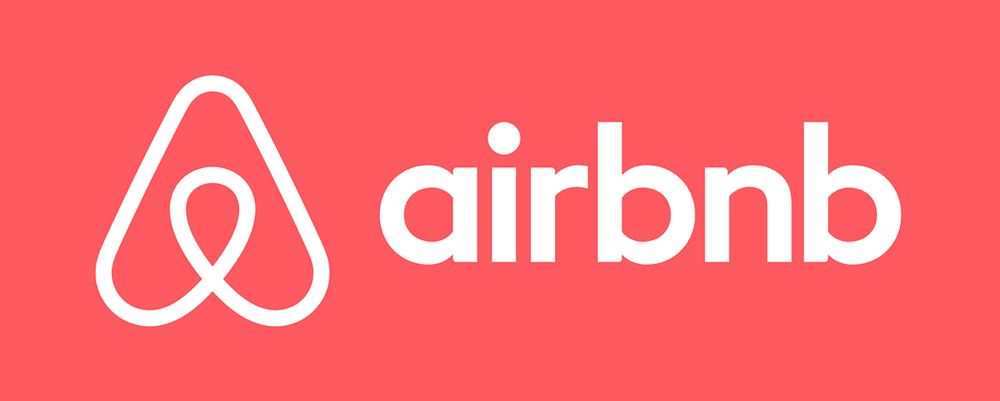

# **Ask**

With the growing competition among Airbnb hosts in Bangkok, this analysis aims to uncover actionable insights to help hosts improve their listing performance. The study will address the following key questions:

**1. Geospatial Competition and Listing Density:**

How does the density and spatial distribution of listings influence competition among Airbnb hosts in various neighborhoods across Bangkok?

**2. Seasonal Trends and Pricing Strategies:**

What seasonal patterns exist in listing availability and pricing, and how can Airbnb hosts adapt their strategies to maximize occupancy throughout the year?

**3. Language and Keywords in Descriptions:**

How do the language, sentiment, and choice of keywords in listing descriptions affect booking rates, review volumes, and pricing strategies?

This analysis will equip Airbnb hosts in Bangkok with practical strategies to optimize their listings, attract more guests, and stand out in a competitive market.

# **Prepare**

**1. Data**

This data is provided by Purwadhika as Capstone Project Module 2. But also can get on kaggle : https://www.kaggle.com/datasets/dyahwitamara/air-bnb-listing-bangkok

**2. Column Description**

These are the columns in the dataset, with their descriptions listed below:

| Column Name                         | Description                                                                 |
|---------------------------------|-----------------------------------------------------------------------------|
| `id`                            | Airbnb's unique identifier for the listing.                                 |
| `name`                          | Name of the listing.                                                        |
| `host_id`                       | Airbnb's unique identifier for the host/user.                               |
| `host_name`                     | Name of the host, usually just the first name(s).                           |
| `neighbourhood`                  | The neighbourhood is geocoded using latitude and longitude.                  |
| `latitude`                      | Latitude of the listing (WGS84 projection).                                 |
| `longitude`                     | Longitude of the listing (WGS84 projection).                                |
| `room_type`                     | Type of room: Entire home/apt, Private room, Shared room, or Hotel.         |
| `price`                         | Daily price in local currency.                                              |
| `minimum_nights`                | Minimum number of nights for a stay.                                        |
| `number_of_reviews`             | Total number of reviews the listing has.                                    |
| `last_review`                   | Date of the last/newest review.                                             |
| `calculated_host_listings_count`| Number of listings the host has in the city/region.                         |
| `availability_365`              | Number of days the listing is available in the next 365 days.               |
| `number_of_reviews_ltm`         | Number of reviews in the last 12 months.                                    |


# **Process**

### **Tools for Analysis**

For this project, I've choosen to use Excel and Python for data analysis. I find Excel's user-friendly interface helpful for exploring and review the dataset, while Python is commonly use to handling large dataset and create visualization. To present my findings, I am using Google Slides.

### **Checking the data for errors**

Based on my review of the Excel data and the contents of each column, I have identified the following steps that need to be taken before analyzing the data:

- NULL value in some columns
- Random character in some columns
- Check for any duplicated rows in the data
- Verify that the data  is in the correct format

### **Data Cleaning**

In [1]:
# Loading Libraries
# Libraries for Data Cleaning and Data Manipulation
import pandas as pd
import numpy as np
# Library for normality test
import scipy.stats as stats
# Libraries for Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
# Other Library
import warnings
warnings.filterwarnings('ignore')

After reviewing the dataset using Excel, I noticed random characters in several columns (such as **'name'** and **'host_name'**), which turned out to be improperly encoded text. This issue is likely caused by **Mojibake** (garbled or gibberish text resulting from incorrect character encoding). This typically happens when text encoded in one character set (e.g., UTF-8) is interpreted using another (e.g., Latin-1).

To address this, I specified the encoding parameter as 'utf-8' when loading the dataset to ensure the text is read correctly.

In [2]:
df = pd.read_csv("Airbnb Listings Bangkok.csv", encoding='utf-8')

df

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.759830,100.541340,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.668180,100.616740,Private room,1316,1,0,NaN,NaN,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.752320,100.624020,Private room,800,60,0,NaN,NaN,1,365,0
3,3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.788230,100.572560,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.768720,100.633380,Private room,1905,1,0,NaN,NaN,3,365,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15849,15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,NaN,NaN,1,362,0
15850,15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShoping...,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,NaN,NaN,14,365,0
15851,15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,NaN,NaN,14,365,0
15852,15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,NaN,NaN,14,365,0


With a quick overview shows that the 'name' column contain non-Latin characters, and the **'last_review'** and **'reviews_per_month'** column have some missing values (NaN).

#### **Data Structue**

First, during the data cleaning process, I will examine the data structure in advance to thoroughly understand the data and identify potential issues that may require attention. Additionally, I'll check for inconsistent formats, such as mixed date formats or variations in text columns, and ensure that key columns have appropriate data types. Addressing these issues will help ensure the dataset is reliable and ready for analysis.

In [3]:
f'Number of rows and columns are : {df.shape}'

'Number of rows and columns are : (15854, 17)'

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      15854 non-null  int64  
 1   id                              15854 non-null  int64  
 2   name                            15846 non-null  object 
 3   host_id                         15854 non-null  int64  
 4   host_name                       15853 non-null  object 
 5   neighbourhood                   15854 non-null  object 
 6   latitude                        15854 non-null  float64
 7   longitude                       15854 non-null  float64
 8   room_type                       15854 non-null  object 
 9   price                           15854 non-null  int64  
 10  minimum_nights                  15854 non-null  int64  
 11  number_of_reviews               15854 non-null  int64  
 12  last_review                     

**Key Points:**

- Out of 17 columns, there are 12 numerical columns (int64, float64) and 5 categorical columns.
- Some columns have missing values, such as **'name'**, **'host_name'**, **'last_review'**, and **'review_per_month'**, as indicated by their Non-Null Count being less than 15,854.
- The 'last_review' column, which contains date data, is currently classified as an object data type. This column needs to be converted to the datetime format.

In [5]:
pd.DataFrame({
    "feature/column": df.columns,
    "data_type": df.dtypes.values,
    "number_of_unique_values": df.nunique().values,
    "unique_values": [df[col].unique() for col in df.columns]
})

,feature/column,data_type,number_of_unique_values,unique_values
0,Unnamed: 0,int64,15854,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,..."
1,id,int64,15854,"[27934, 27979, 28745, 35780, 941865, 1704776, ..."
2,name,object,14794,"[Nice room with superb city view, Easy going l..."
3,host_id,int64,6659,"[120437, 120541, 123784, 153730, 610315, 21296..."
4,host_name,object,5312,"[Nuttee, Emy, Familyroom, Sirilak, Kasem, Wimo..."
5,neighbourhood,object,50,"[Ratchathewi, Bang Na, Bang Kapi, Din Daeng, B..."
6,latitude,float64,9606,"[13.75983, 13.66818, 13.75232, 13.78823, 13.76..."
7,longitude,float64,10224,"[100.54134, 100.61674, 100.62402, 100.57256, 1..."
8,room_type,object,4,"[Entire home/apt, Private room, Hotel room, Sh..."
9,price,int64,3040,"[1905, 1316, 800, 1286, 1000, 1558, 1461, 700,..."


Several important insights can be highlighted:

- **Dataset Size and Host Representation:** The dataset includes 15,854 listings with distinct ID values and 6,659 unique hosts, indicating that some hosts manage multiple properties.
- **Variety in Locations and Room Types:** With 50 unique neighborhoods and 4 room types, the dataset covers a wide range of geographic areas and accommodation options.
- **Pricing Diversity:** The price column features 3,040 unique values, illustrating a significant variation in listing prices.
- **Engagement Levels:** The **'number_of_reviews'** column contains 298 unique values, reflecting varied levels of guest interaction across listings.
- **Host Management:** Host activity is notable, with 50 unique values in the **'calculated_host_listings_count'**, showing that many hosts handle multiple properties.

#### **Data Quality**

The next step is to check the data quality. This involves identifying missing values, detecting duplicates, ensuring data consistency, and validating the accuracy of the information. I will also look for outliers in numerical data and verify that all values fall within expected ranges.

**Missing Values**

First, we will identify any missing values within the dataset and determine appropriate strategies to handle them if they are found.

In [6]:
df.isnull().sum()

Unnamed: 0                           0
id                                   0
name                                 8
host_id                              0
host_name                            1
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       5790
reviews_per_month                 5790
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
dtype: int64

Now we have identified the exact number of missing values in the dataset:

The **'name'** column has 8 missing values, and the **'host_name'** column has 1 missing value, possibly due to errors during data entry.
The **'last_review'** and **'reviews_per_month'** columns have the same number of missing values. To address this, analyzing the relationship between these two columns may be necessary to determine an appropriate handling strategy.

**Duplicated Data**

Next, let's identify any duplicated data that may exist and address it if found.

In [7]:
df.duplicated().sum()

np.int64(0)

We have confirmed that there are no duplicate entries in the dataset when considering all columns. However, I would like to check if there are any listings assigned to multiple hosts

In [8]:
data_duplicate = df[df.duplicated(subset=['longitude', 'latitude','last_review','price','name','room_type'])]
len(data_duplicate)


14

In [9]:
data_duplicate.groupby(['name','latitude','longitude','host_name'])[['id']].count()

id
name                                               latitude  longitude  host_name    
Family Room for 4 People                           13.740168 100.556320 Rachan      1
Luxury 1 Bed/Central Rama9/Jodds Fair/Phra ram9    13.756184 100.568269 Tricia      1
                                                                        Willam      1
                                                   13.757097 100.568486 Alice       1
NA BANGLAMPOO GUEST HOUSE                          13.762790 100.497900 Yui         1
New! Gateway/ Bangkok University 1BR 2PPL near BTS 13.716669 100.584967 Noons       1
Sathon Luxury 2 br/China Town/Icon Siam            13.710777 100.519891 Alex        1
                                                                        Alice       2
                                                                        Tricia      1
                                                                        Willam      1
Sathon Luxury Loft/China Town/Icon Siam            13.710777 100.519891 Alex        1
                                                                        Alice       1
small1                                             13.920720 100.575780 Soo         1

In the duplicate data identified, it is evident that listings with identical names and the same latitude and longitude are registered under different host names. This could be a deliberate strategy employed by the listing to enhance visibility, improve its chances of attracting potential guests, or allow each host to target specific audience segments (e.g., families, budget travelers).

Given this assumption, addressing these duplicates is not immediately necessary. However, they will be revisited and handled appropriately in subsequent analyses as required.

**Anomalies**

Next step is checking anomalies and outliers using descriptive statistic, as it is crucial to understand the overall distribution of data.  This step helps in identifying anomalies, which are important to ensure accurate and reliable analysis.

In [10]:
df.describe()

,Unnamed: 0,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,15854.000000,1.585400e+04,1.585400e+04,15854.000000,15854.000000,1.585400e+04,15854.000000,15854.000000,10064.000000,15854.000000,15854.000000,15854.000000
mean,7926.500000,1.579397e+17,1.541058e+08,13.745144,100.559903,3.217704e+03,15.292355,16.654157,0.813145,13.889618,244.378643,3.481519
std,4576.799919,2.946015e+17,1.318726e+08,0.043040,0.050911,2.497212e+04,50.815020,40.613331,1.090196,30.269848,125.843224,8.916937
min,0.000000,2.793400e+04,5.892000e+04,13.527300,100.329550,0.000000e+00,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000
25%,3963.250000,2.104509e+07,3.974431e+07,13.720090,100.529690,9.000000e+02,1.000000,0.000000,0.120000,1.000000,138.000000,0.000000
50%,7926.500000,3.503734e+07,1.224556e+08,13.738490,100.561415,1.429000e+03,1.000000,2.000000,0.435000,4.000000,309.000000,0.000000
75%,11889.750000,5.256154e+07,2.390547e+08,13.759497,100.585150,2.429000e+03,7.000000,13.000000,1.060000,13.000000,360.000000,3.000000
max,15853.000000,7.908162e+17,4.926659e+08,13.953540,100.923440,1.100000e+06,1125.000000,1224.000000,19.130000,228.000000,365.000000,325.000000


**Key Point:**

- The descriptive statistic reveal an anomaly in **'price'** column, where the minimum price is 0, which is unrealistic for accommodation, as it is unlikely for the price to be 0.
- Additionally, the **'minimum_nights'** column displays a wide range, with a minimum of 1 and a maximum of 1125. Notably, the third quartile (Q3) is only 7, it might indicating the presence of significant outliers.
- Other columns might also contain outliers, which will be addressed later based on further analysis.

**Cleaning Process**

After thoroughly examining the dataset, including its structure and quality, we proceeded to address the following aspects to ensure the data is clean and ready for analysis:

**1. Missing values**

Upon examining the **'name'** column, it has been identified as the description of the listings. Missing values in this column are likely due to incomplete listing entries or errors during data entry or the export process. To address this, I will fill the missing values with "No Description" to ensure consistency in the dataset.

In [11]:
df['name'].fillna('No Description', inplace=True)
df['host_name'].fillna('Unknown', inplace=True)

Next, for the missing values in the **'last_review'** and **'reviews_per_month'** columns, since they have the same number of missing values, I assume that the missing values occurs because of the absence of reviews for these listings. To confirm this, we can apply a filter to check whether the **'last_review'** and **'reviews_per_month'** columns are NaN while the **'number_of_reviews'** column equals 0.

In [12]:
# Verify the assumption
df[(df["number_of_reviews"] == 0) & (df["last_review"].isna()) & (df["reviews_per_month"].isna())]

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.668180,100.616740,Private room,1316,1,0,NaN,NaN,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.752320,100.624020,Private room,800,60,0,NaN,NaN,1,365,0
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.768720,100.633380,Private room,1905,1,0,NaN,NaN,3,365,0
7,7,1738669,1 chic bedroom apartment in BKK,7045870,Jiraporn,Chatu Chak,13.829250,100.567370,Entire home/apt,1461,1,0,NaN,NaN,1,365,0
14,14,959254,"Deluxe Condo, Nana, Pool/GYM/Sauna",5153476,Natcha,Khlong Toei,13.715160,100.568060,Entire home/apt,1400,30,0,NaN,NaN,1,365,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15849,15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,NaN,NaN,1,362,0
15850,15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShoping...,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,NaN,NaN,14,365,0
15851,15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,NaN,NaN,14,365,0
15852,15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,NaN,NaN,14,365,0


The row count remains unchanged at 5,790, verifying that the missing values result from the absence of reviews for these listings. To handle this, the missing values in the **'reviews_per_month'** column will be replaced with "0," while a default datetime value will be assigned to the **'last_review'** column to maintain its expected datetime format. This approach ensures consistency within the dataset, preparing it for further analysis.

In [13]:
df['last_review'] = pd.to_datetime(df['last_review'], errors='coerce')
df['last_review'].fillna(pd.to_datetime("2000-01-01"), inplace=True)
df['reviews_per_month'].fillna(0, inplace=True)
df

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.759830,100.541340,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.668180,100.616740,Private room,1316,1,0,2000-01-01,0.00,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.752320,100.624020,Private room,800,60,0,2000-01-01,0.00,1,365,0
3,3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.788230,100.572560,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.768720,100.633380,Private room,1905,1,0,2000-01-01,0.00,3,365,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15849,15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,2000-01-01,0.00,1,362,0
15850,15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShoping...,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,2000-01-01,0.00,14,365,0
15851,15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,2000-01-01,0.00,14,365,0
15852,15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,2000-01-01,0.00,14,365,0


**2. Handling Anomaly**

Earlier, we identified a row in the **'price'** column with a value of 0. This value is considered an anomaly, as accommodations are typically not free. To address this, I have decided to remove this row to maintain the quality of the dataset.

In [14]:
df[df['price'] == 0]

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
11103,11103,44563108,Somerset Maison Asoke Bangkok,360620448,Somerset Maison Asoke,Vadhana,13.73815,100.5642,Hotel room,0,1,0,2000-01-01,0.0,1,0,0


In [15]:
df = df.drop(index=11103, axis=0)
df.reset_index(drop=True, inplace=True)

**3. Dropping Unnecessary Columns**

To optimize the dataset and focus on the most relevant information, columns that do not contribute to the analysis will be removed. Specifically, the **'Unnamed: 0'**, **'id'**, and **'host_id'** columns will be dropped for the following reasons:

- **Unnamed: 0**: This column is typically an index from a previously saved file and holds no analytical value.
- **id**: While it uniquely identifies each listing, it does not provide meaningful insights for the analysis.
- **host_id**: Similar to id, this column serves as a host identifier but is not necessary for extracting actionable insights.

Eliminating these columns will reduce unnecessary complexity and improve the clarity and efficiency of the dataset for analysis.

In [16]:
df.drop(columns=['Unnamed: 0', 'id', 'host_id'], inplace=True)
df

,name,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,Nice room with superb city view,Nuttee,Ratchathewi,13.759830,100.541340,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,"Easy going landlord,easy place",Emy,Bang Na,13.668180,100.616740,Private room,1316,1,0,2000-01-01,0.00,2,358,0
2,modern-style apartment in Bangkok,Familyroom,Bang Kapi,13.752320,100.624020,Private room,800,60,0,2000-01-01,0.00,1,365,0
3,Spacious one bedroom at The Kris Condo Bldg. 3,Sirilak,Din Daeng,13.788230,100.572560,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,Suite Room 3 at MetroPoint,Kasem,Bang Kapi,13.768720,100.633380,Private room,1905,1,0,2000-01-01,0.00,3,365,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15848,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,2000-01-01,0.00,1,362,0
15849,Euro LuxuryHotel PratunamMKt TripleBdNrShoping...,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,2000-01-01,0.00,14,365,0
15850,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,2000-01-01,0.00,14,365,0
15851,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,2000-01-01,0.00,14,365,0


In [17]:
f'Total rows dan columns after cleaning {df.shape}'

'Total rows dan columns after cleaning (15853, 14)'

In [18]:
display(df.describe(), df.describe(include=object))

,latitude,longitude,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,15853.000000,15853.000000,1.585300e+04,15853.000000,15853.000000,15853,15853.000000,15853.000000,15853.000000,15853.000000
mean,13.745144,100.559903,3.217907e+03,15.293257,16.655207,2013-10-02 00:33:25.626695424,0.516211,13.890431,244.394058,3.481738
min,13.527300,100.329550,2.780000e+02,1.000000,0.000000,2000-01-01 00:00:00,0.000000,1.000000,0.000000,0.000000
25%,13.720090,100.529690,9.000000e+02,1.000000,0.000000,2000-01-01 00:00:00,0.000000,1.000000,138.000000,0.000000
50%,13.738490,100.561410,1.429000e+03,1.000000,2.000000,2020-01-12 00:00:00,0.090000,4.000000,309.000000,0.000000
75%,13.759500,100.585150,2.429000e+03,7.000000,13.000000,2022-11-22 00:00:00,0.670000,13.000000,360.000000,3.000000
max,13.953540,100.923440,1.100000e+06,1125.000000,1224.000000,2022-12-28 00:00:00,19.130000,228.000000,365.000000,325.000000
std,0.043041,0.050912,2.497290e+04,50.816496,40.614397,NaN,0.952774,30.270630,125.832224,8.917176


,name,host_name,neighbourhood,room_type
count,15853,15853,15853,15853
unique,14794,5312,50,4
top,New! La Chada Night Market studio 2PPL near MRT,Curry,Vadhana,Entire home/apt
freq,45,228,2152,8912


**4. Examining Data Distribution**

Understanding the distribution of data is crucial for several reasons:

1. **Identifying Skewness:** Determines if the data is symmetric or skewed, which impacts the choice of statistical tests and models.
2. **Detecting Outliers:** Helps in spotting outliers that may affect the analysis.
Choosing the Right Model: Some models assume a normal distribution of data, so understanding the distribution helps in model selection.
3. **Data Transformation Needs:** Non-normal data might require transformations for more accurate analysis.

In [19]:
df.select_dtypes(include=['int64', 'float64'])

,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,13.759830,100.541340,1905,3,65,0.50,2,353,0
1,13.668180,100.616740,1316,1,0,0.00,2,358,0
2,13.752320,100.624020,800,60,0,0.00,1,365,0
3,13.788230,100.572560,1286,7,2,0.03,1,323,1
4,13.768720,100.633380,1905,1,0,0.00,3,365,0
...,...,...,...,...,...,...,...,...,...
15848,13.715132,100.653458,2298,28,0,0.00,1,362,0
15849,13.753052,100.538738,1429,1,0,0.00,14,365,0
15850,13.753169,100.538700,1214,1,0,0.00,14,365,0
15851,13.754789,100.538757,1214,1,0,0.00,14,365,0


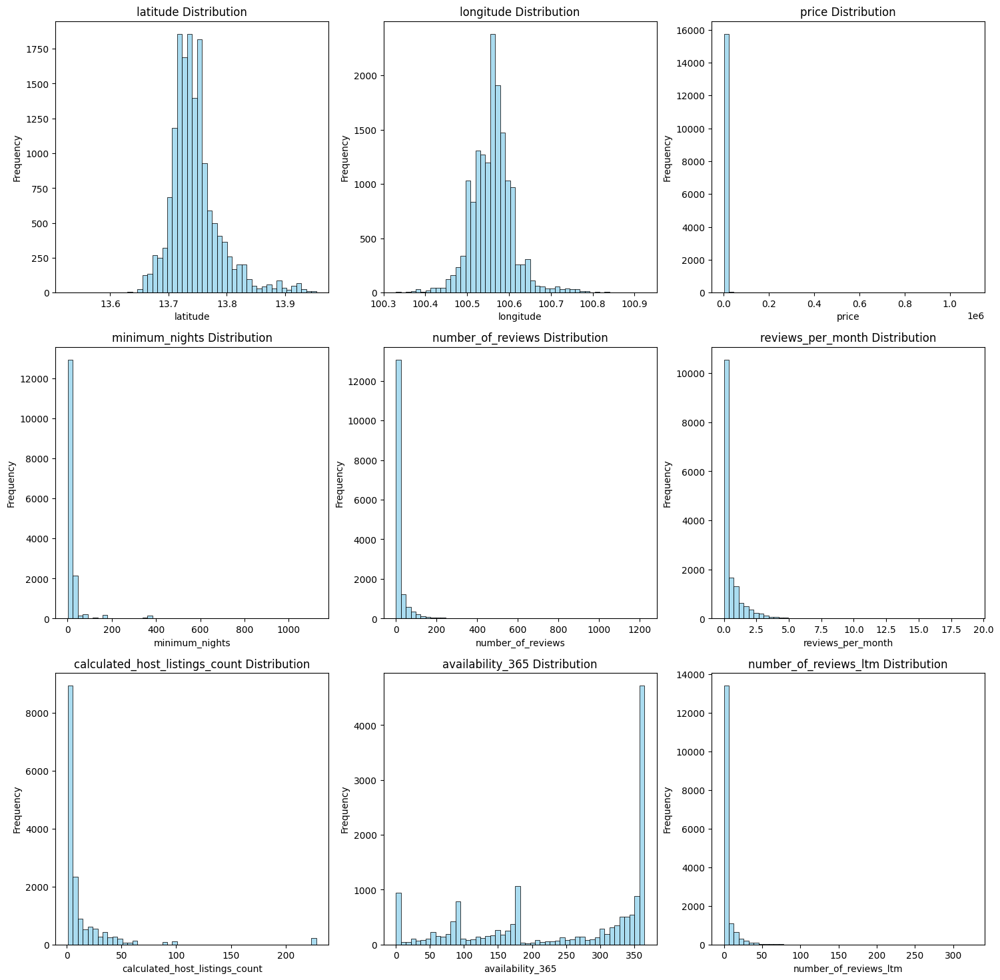

In [20]:
# Check Distribution
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns

num_cols = len(numerical_cols)

rows = (num_cols) // 3

plt.figure(figsize=(18, 6 * rows))

for i, col in enumerate(numerical_cols):
    plt.subplot(rows, 3, i + 1)
    
    sns.histplot(df[col], bins=50, color="skyblue", edgecolor="black", alpha=0.7)
    plt.title(f"{col} Distribution")
    plt.xlabel(col)
    plt.ylabel("Frequency")

In [21]:
normality_test = {}

for i, col in enumerate(numerical_cols):
    # Perform the Shapiro-Wilk Test for normality
    shapiro_test = stats.shapiro(df[col])

    # Perform the D'Agostino's K-squared Test for normality
    dagostino_test = stats.normaltest(df[col])

    # Calculate the skewness
    skewness = df[col].skew()

    # Determine the skew direction
    if skewness > 0:
        skew_direction = "Positive"
    elif skewness < 0:
        skew_direction = "Negative"
    else:
        skew_direction = "None"

    # Storing the results
    normality_test[col] = {
        "Shapiro-Wilk Statistic": shapiro_test.statistic,
        "Shapiro-Wilk p-value": shapiro_test.pvalue,
        "D'Agostino Statistic": dagostino_test.statistic,
        "D'Agostino p-value": dagostino_test.pvalue,
        "Skewness": skewness,
        "Skew Direction": skew_direction
    }

# Convert the dictionary to a DataFrame
normality_results_df = pd.DataFrame(normality_test).T

# Adding a column to indicate if the data is normally distributed based on p-values
normality_results_df["Normally Distributed"] = (normality_results_df["Shapiro-Wilk p-value"] > 0.05) & (normality_results_df["D'Agostino p-value"] > 0.05)

normality_results_df

,Shapiro-Wilk Statistic,Shapiro-Wilk p-value,D'Agostino Statistic,D'Agostino p-value,Skewness,Skew Direction,Normally Distributed
latitude,0.90341,0.0,4356.959559,0.0,1.401384,Positive,False
longitude,0.95221,0.0,2077.433462,0.0,0.559228,Positive,False
price,0.044418,0.0,43046.717756,0.0,33.882198,Positive,False
minimum_nights,0.279787,0.0,22190.129178,0.0,8.229398,Positive,False
number_of_reviews,0.441057,0.0,19163.17247,0.0,6.261361,Positive,False
reviews_per_month,0.579128,0.0,15621.035696,0.0,4.628295,Positive,False
calculated_host_listings_count,0.417437,0.0,16474.501173,0.0,5.386583,Positive,False
availability_365,0.832341,0.0,12885.350519,0.0,-0.576219,Negative,False
number_of_reviews_ltm,0.411577,0.0,24895.698981,0.0,9.725723,Positive,False


It is evident that none of the numerical data follows a normal distribution.

These outliers will be addressed in subsequent analyses, where their impact will be evaluated based on the specific context and goals of the study.

# **Analyze**

To provide actionable recommendations, a series of analyses will be conducted, including the following:

### **1. Geospatial Competition Analysis**
Visualize the geographic distribution of Airbnb listings across different neighbourhoods in Bangkok to understand competition intensity.

### **2. Seasonal Trends and Pricing Analysis**
Identify and analyze seasonal trends in listing availability and pricing to guide dynamic pricing strategies.

### **3. Engagement Based on Review**
Analyze guest engagement based on review to optimize their listings and stay competitive in a dynamic market.

### **4. Listing Description and Keyword Analysis**
Assess the effectiveness of different keywords, sentiments, and languages used in listing descriptions to optimize for bookings and reviews.

## **Geospatial Analysis**

The Geospatial Competition Analysis focuses on mapping the distribution of Airbnb listings across Bangkok's neighborhoods to assess the competitive landscape. Using latitude and longitude data, the analysis identifies areas with dense clusters of Airbnb properties, pinpointing neighborhoods with high competition as well as those with growth opportunities.

The analysis also incorporates distance calculations from each listing to popular tourist destinations using the **Haversine formula**. The **Haversine formula** calculates the shortest distance between two points on a sphere using their latitudes and longitudes measured along the surface. This helps evaluate how proximity to key attractions impacts pricing. By combining insights from geographic distribution and attraction proximity, this study sheds light on how location influences competition and pricing, aiding in strategic decisions for listing new properties and optimizing market positioning.

In [22]:
import json

with open('Bangkok-districts.geojson', encoding='utf-8') as f:
    geojson_data = json.load(f)

# Map Bangkok
bangkok_map = folium.Map(location = [13.7563, 100.5018], 
                         zoom_start = 12,
                         max_bounds = True,
                         min_zoom = 10,
                         max_zoom = 15,
                         max_bounds_readable = True
                         )

for feature in geojson_data['features']:
    neighborhood_coords = feature['geometry']['coordinates'][0]

    folium.PolyLine(
        locations=[[coord[1], coord[0]] for coord in neighborhood_coords],
        color='blue',
        weight=2,
        dash_array='5, 5'
    ).add_to(bangkok_map)

marker_cluster = MarkerCluster().add_to(bangkok_map)

room_type_icons = {
    "Entire home/apt": ("blue", "home"),
    "Private room": ("lightgray", "user"),
    "Hotel room": ("green", "hotel"),
    "Shared room": ("gray", "users")
}

for latitude, longitude, neighbourhood, room_type, price in zip(df["latitude"], df["longitude"], df["neighbourhood"], df["room_type"], df["price"]):
    color, icon = room_type_icons.get(room_type, ("black", "question-sign"))
    
    folium.Marker(
        location=[latitude, longitude],
        popup=f"Neighbourhood: {neighbourhood}\nRoom Type: {room_type}\nPrice: {price} Baht",
        icon=folium.Icon(color=color, icon=icon, prefix='fa')
    ).add_to(marker_cluster)

tourist_spots = {
    "Grand Palace": [13.7515, 100.4927],
    "Siam Paragon": [13.7462, 100.5349],
    "MBK Center": [13.7446, 100.5296],
    "Chatuchak Market": [13.7990, 100.5500],
    "Wat Arun": [13.7437, 100.4886],
    "Wat Pho": [13.7466, 100.4923],
    "Khao San Road": [13.7594, 100.4976],
    "Yaowarat": [13.7402796, 100.5071928],
    "Lumphini Park": [13.7314281, 100.5391235],
    "Siam Amazing Park": [13.8151288, 100.6320818]
}

for spot, koordinat in tourist_spots.items():
    folium.Marker(
        location=koordinat,
        tooltip=f"Tourist Spot: {spot}",
        icon=folium.Icon(color="red", icon="info-sign")
    ).add_to(bangkok_map)

folium.LayerControl().add_to(bangkok_map)

bangkok_map

Geospatial Competition Analysis Insights for Airbnb Listings in Bangkok:

**1. High-Density Neighbourhoods and Competitive Pressure:**

Some neighbourhoods have a high concentration of Airbnb listings, resulting in intense competition among hosts. New listings in these areas may struggle to gain visibility unless they stand out with unique features or competitive pricing. Hosts should focus on differentiation strategies in these competitive zones or explore opportunities in less saturated neighbourhoods for new listings.

**2. Potential in Underserved Neighbourhoods:**
Neighbourhoods with fewer listings represent opportunities for growth. These less competitive areas may offer untapped potential, particularly if they have good transportation links or are near emerging attractions. Targeting such areas could be a strategic move for new listings or market expansion.

**3. Geographical Price Disparities:**

Listing prices show significant geographic variation, with properties in central and tourist-heavy areas typically commanding higher rates. Understanding these trends is crucial for developing effective pricing strategies. Hosts in central locations might capitalize on premium pricing, while those in suburban areas may benefit from value-focused pricing to attract guests.

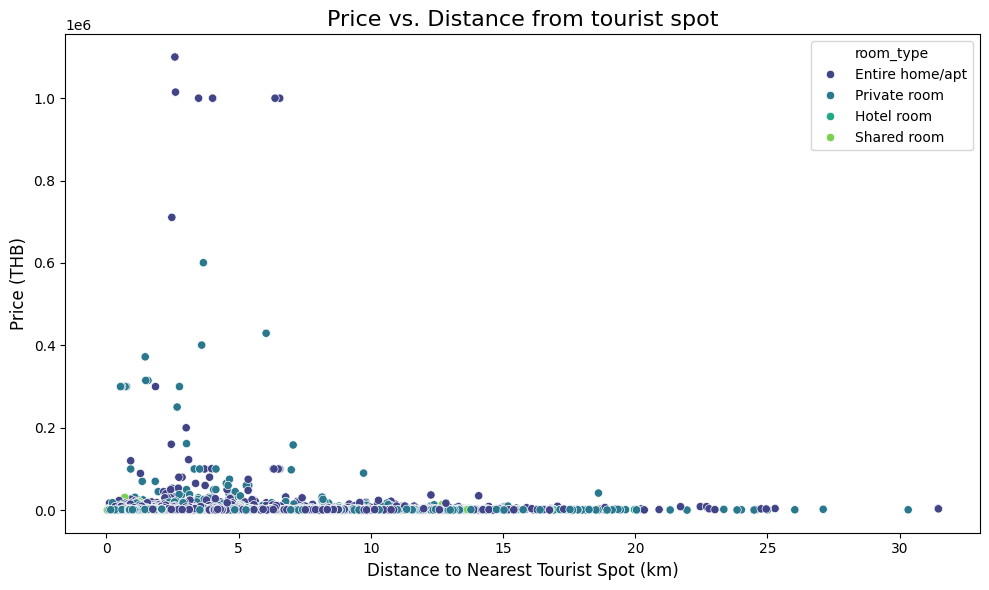

In [23]:
def haversine(lat1, lon1, lat2, lon2):
    # Convert latitude and longitude from degrees to radians
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])

    # Haversine formula
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = np.sin(dlat / 2.0) ** 2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2.0) ** 2
    c = 2 * np.arcsin(np.sqrt(a))
    km = 6371 * c  # Radius of Earth in kilometers
    return km

# Calculate the minimum distance from each listing to the nearest tourist spot
for spot, coords in tourist_spots.items():
    df[f"distance_to_{spot.replace(' ', '_').lower()}"] = df.apply(
        lambda row: haversine(row["latitude"], row["longitude"], coords[0], coords[1]), axis=1
    )

# Calculate the minimum distance to any tourist spot
distance_columns = [f"distance_to_{spot.replace(' ', '_').lower()}" for spot in tourist_spots.keys()]
df["min_distance_to_tourist_spot"] = df[distance_columns].min(axis=1)

# Analyze the relationship between distance to tourist spots and price
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x="min_distance_to_tourist_spot", y="price", hue="room_type", palette="viridis")
plt.title("Price vs. Distance from tourist spot", fontsize=16)
plt.xlabel("Distance to Nearest Tourist Spot (km)", fontsize=12)
plt.ylabel("Price (THB)", fontsize=12)
plt.tight_layout()
plt.show()

- The scatterplot highlights the correlation between listing prices and their distance from major tourist attractions in Bangkok. Listings located closer to popular destinations tend to have higher prices, reflecting the added value of a prime location. This suggests that new properties near tourist hotspots could implement premium pricing strategies to optimize revenue.

- The analysis also indicates that room types influence pricing. Marketing strategies can emphasize the convenience and appeal of staying near key attractions, especially for high-end listings. Furthermore, targeted campaigns can cater to specific traveler groups by aligning accommodation types with their preferences and proximity to tourist destinations.

#### **Strategic Insights**
Analyzing Airbnb listings in Bangkok provides valuable insights into the competitive landscape, shaping strategies for location, pricing, and marketing. Key findings include:

**1. Competitive Hotspots**

**Insight:** Certain neighborhoods, especially central areas and those near key attractions, have a high density of listings, indicating intense competition. These areas are popular with tourists and attract numerous hosts.

**Implications:** New listings in such neighborhoods must stand out by offering unique features, competitive pricing, or enhanced amenities to capture guest attention. Marketing strategies should highlight these advantages to remain competitive.

**2. Value of Proximity to Attractions**

**Insight:** Listings closer to tourist hotspots tend to charge higher prices due to the premium on convenience and access. These areas are highly desirable for visitors seeking proximity to landmarks and cultural sites.

**Implications:** Listings in these areas can implement premium pricing strategies to maximize revenue. Proximity to attractions should be highlighted in marketing efforts to appeal to travelers seeking convenience.

**3. Opportunities in Less Saturated Areas**

**Insight:** Some neighborhoods have fewer listings, indicating lower competition and potential demand. These areas, though less central, may offer unique benefits such as quieter surroundings or proximity to emerging attractions.

**Implications:** Hosts can capitalize on these underrepresented areas by targeting niche markets. Highlighting a “local” experience or promoting tranquil settings can attract travelers seeking alternatives to busy tourist spots.

This analysis equips Airbnb hosts with actionable strategies to optimize their listings, tailor their offerings to specific markets, and identify opportunities in both competitive and untapped areas.

#### **Strategic Recommendations**
**Stand Out in Competitive Areas:**

- In neighborhoods with high competition, hosts should focus on making their listings unique. Offering standout features, exceptional amenities, or personalized guest experiences can attract more bookings. Strategic pricing and appealing design can also help differentiate properties in crowded markets.

**Capitalize on Proximity to Tourist Hotspots:**

- Listings near key attractions should leverage their location advantage in promotional efforts. Adopting premium pricing strategies and emphasizing convenience in marketing materials can attract tourists who prioritize accessibility to landmarks and cultural sites.

**Tap Into Underserved Neighborhoods:**

- Consider listing properties in areas with fewer Airbnb options. These locations can provide unique experiences, such as peaceful settings or local cultural immersion, which can appeal to niche markets. Lower competition in these neighborhoods offers an opportunity for new listings to establish a strong presence.

#### **Conclusion**

Geospatial dynamics significantly influence the performance of Airbnb listings in Bangkok. By analyzing competition levels and the accessibility to popular tourist destinations, hosts can strategically determine property locations, set optimal pricing, and tailor marketing efforts to attract more guests. Applying these insights effectively can result in increased occupancy, enhanced guest satisfaction, and improved profitability.

## **Seasonal Trend**

To analyze seasonal trends and pricing, the 'last_review' column, which indicates the most recent review date for each property, is a key resource. By converting this column into a datetime format, the month and year of each review can be extracted. This enables a deeper understanding of recent guest interactions and patterns in booking behavior throughout the year.

By grouping the data by month, the analysis examines the average price, total number of reviews, and availability trends over time. This approach highlights seasonal demand by reflecting current guest activity, helping identify peak booking periods and optimize pricing and availability strategies.

**However**, it is important to acknowledge that this analysis may not fully capture all seasonal patterns, especially for listings with fewer reviews or irregular guest interactions.

In [24]:
df_filtered = df[df["last_review"] != "2000-01-01"]

df_filtered["review_month"] = df_filtered["last_review"].dt.month
df_filtered["review_year"] = df_filtered["last_review"].dt.year

monthly_trends = df_filtered.groupby("review_month").agg(
    avg_price=("price", "mean"),
    total_reviews=("number_of_reviews", "sum")
).reset_index()

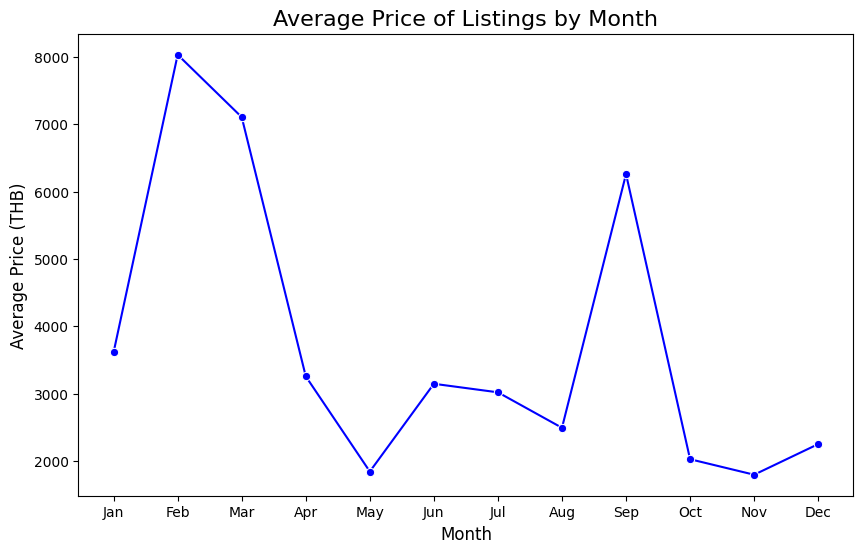

In [25]:
month_order = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

plt.figure(figsize=(10, 6))
sns.lineplot(data=monthly_trends, x="review_month", y="avg_price", marker="o", color="blue")
plt.title("Average Price of Listings by Month", fontsize=16)
plt.xlabel("Month", fontsize=12)
plt.ylabel("Average Price (THB)", fontsize=12)
plt.xticks(range(1, 13), month_order)
plt.show()

The graph shows how the average price of listings fluctuates throughout the year. Prices tend to peak during certain months, likely due to increased demand during tourist seasons or holidays. Understanding these trends allows hosts to implement dynamic pricing strategies, adjusting prices based on expected demand to maximize revenue.

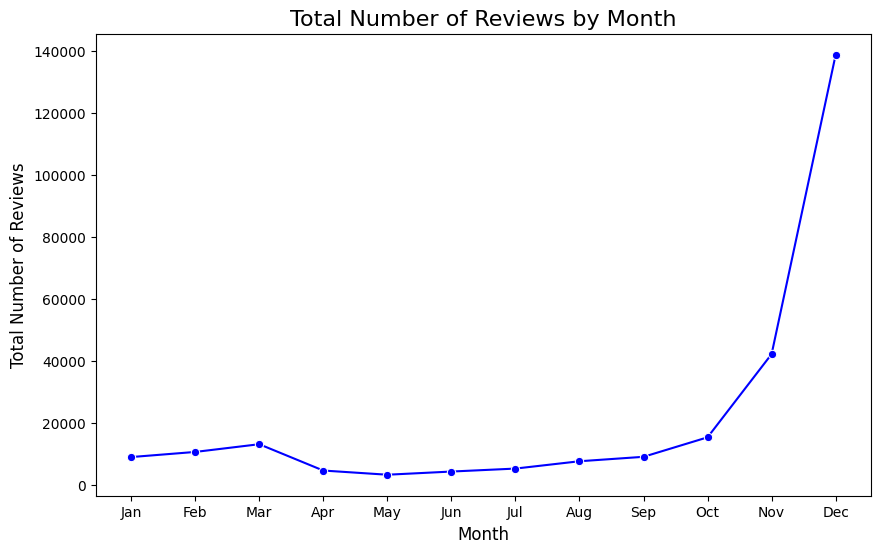

In [26]:
# Number of Reviews by Month
plt.figure(figsize=(10, 6))
sns.lineplot(data=monthly_trends, x="review_month", y="total_reviews", marker="o", color="blue")
plt.title("Total Number of Reviews by Month", fontsize=16)
plt.xlabel("Month", fontsize=12)
plt.ylabel("Total Number of Reviews", fontsize=12)
plt.xticks(range(1, 13), month_order)
plt.show()

The graph illustrates the total number of reviews per month, serving as a proxy for occupancy or booking activity. Months with higher review counts indicate periods of increased guest activity, which could correlate with peak tourism seasons. Marketing campaigns should be intensified during these high-activity months to attract more bookings, while promotions or discounts could be offered during off-peak periods to boost occupancy.

#### **Strategic Insight**
Seasonality heavily influences the dynamics of Airbnb listings in Bangkok, affecting pricing, occupancy rates, and availability. Key takeaways include:

**1. Pricing Variations:**

- **Insight:** Average listing prices fluctuate throughout the year, with notable spikes during high-demand periods like holidays or festivals.
- **Action:** Hosts can optimize revenue by raising prices during peak seasons. In contrast, lowering rates during off-peak times may help attract bookings and stay competitive.

**2. Occupancy and Booking Trends:**

- **Insight:** Seasonal patterns are reflected in review counts, which serve as a proxy for occupancy. Higher review counts in specific months indicate increased booking activity coinciding with tourist seasons.
- **Action:** During high-demand months, hosts can rely on natural demand without offering discounts. In quieter months, promotions and strategic marketing efforts can help fill vacancies and ensure steady revenue.

#### **Strategic Recommendations**

**1. Dynamic Pricing:** Adopt a pricing strategy that adjusts rates in response to seasonal demand. This approach ensures maximum revenue during peak seasons and maintains competitiveness during slower periods.

**2. Seasonal Marketing:** Tailor marketing efforts to align with seasonal trends. Focus on high-demand months to secure more bookings, and use promotions or discounts during off-peak times to encourage reservations.

#### **Conclusion**
Seasonality plays a crucial role in Bangkok’s Airbnb market, influencing pricing, marketing, and availability strategies. By adapting to these trends, hosts can achieve higher occupancy rates, optimize revenue, and maintain their competitive position year-round.

## **Engagement Scores Based on Review**

Understanding guest engagement is crucial for Airbnb hosts who want to optimize their listings and stay competitive in a dynamic market. Engagement metrics provide insights into how often listings attract interest and bookings, which can be influenced by factors such as reviews, location, and pricing. This analysis focuses on calculating an Engagement Score for Airbnb listings, derived from two key metrics:

**1. Number_of_Reviews (NoR):** Represents the overall popularity of a listing over time.

**2. Reviews_per_Month (RpM):** Indicates the consistency of guest interest and activity on a monthly basis.

To calculate the **Engagement Score**, we use the following formula:

    Engagement Score = (Number of Reviews × Weight (NoR)) + (Normalized Reviews per Month × Weight (RpM))

Here’s an explanation of the formula components:

- **Weight Assignment:**

    - **70% (Weight(NoR))** is assigned to the number of reviews. This reflects the long-term popularity and trustworthiness of a listing, as higher review counts often correlate with consistent guest interest.

    - **30% (Weight(RpM))** is assigned to reviews per month. This metric highlights current and ongoing engagement, ensuring that recent activity is also considered.

- **Normalization:**

    To balance the scales between the two metrics, the **Reviews per Month** is normalized by dividing it by the maximum value in the dataset. This ensures both metrics contribute proportionally to the final Engagement Score.

By combining these metrics, we aim to identify the top listings with the highest engagement, offering valuable insights for Airbnb hosts to improve their offerings and marketing strategies.

In [27]:
df['normalized_rpm'] = df['reviews_per_month'] / df['reviews_per_month'].max()

weight_nor = 0.7  
weight_rpm = 0.3  
df['engagement'] = (df['number_of_reviews'] * weight_nor) + (df['normalized_rpm'] * weight_rpm)

df_sorted = df.sort_values(by='engagement', ascending=False).head(10) 

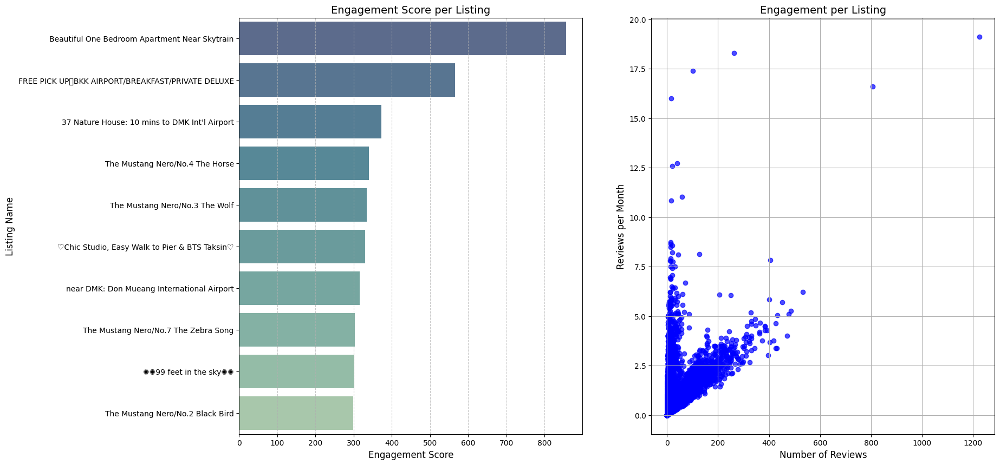

<Figure size 640x480 with 0 Axes>

In [28]:

plt.figure(figsize=(18, 10))
plt.subplot(1, 2, 1)
pal = sns.color_palette('crest', len(df_sorted))
rank = df_sorted['engagement'].argsort().argsort()
sns.barplot(x='engagement', y='name', data=df_sorted, palette=np.array(pal[::])[rank], alpha=0.8)

plt.title("Engagement Score per Listing", fontsize=14)
plt.xlabel("Engagement Score", fontsize=12)
plt.ylabel("Listing Name", fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.7)

plt.subplot(1, 2, 2)
plt.scatter(df['number_of_reviews'], df['reviews_per_month'], alpha=0.7, c='blue')
plt.title("Engagement per Listing", fontsize=14)
plt.xlabel("Number of Reviews", fontsize=12)
plt.ylabel("Reviews per Month", fontsize=12)
plt.grid(True)
plt.show()

plt.tight_layout()

plt.show()

**Insights from the Engagement Analysis**

**1. Top-Engaged Listings:**

The listings with the highest Engagement Scores tend to have both a significant number of historical reviews and consistent monthly reviews. This indicates that long-term popularity and ongoing guest interest are key factors in driving engagement.

**2. Influence of Review Metrics:**

Listings with a high number of reviews tend to dominate the engagement rankings, reinforcing the importance of building a strong review history to gain guest trust and attract more bookings.
Listings with a high reviews per month score, even if their total review count is moderate, still rank well. This suggests that consistent, recent activity can positively impact a listing's visibility and attractiveness.

**3. Balanced Weighting:**

The weighting formula (70% for total reviews and 30% for normalized monthly reviews) ensures that both historical credibility and recent trends are considered. This balance helps identify listings that are not only popular but also actively engaging guests in the present.

**4. Opportunities for Improvement:**

Listings with moderate total reviews but low monthly reviews may benefit from improved marketing or adjustments to pricing to sustain guest interest.
Conversely, newer listings with strong monthly reviews but fewer total reviews could focus on building a review base by encouraging satisfied guests to leave feedback.


#### **Strategic Recommendations**
For Airbnb hosts:

- **Enhancing Long-Term Engagement:** Focus on maintaining consistent quality and encouraging guests to leave reviews to increase total review counts over time.
- **Boosting Monthly Activity:** Implement short-term strategies like promotional pricing or targeted marketing to boost bookings and reviews in the short term, especially for newer listings.
- **Learning from Top Listings:** Study the features, pricing, and descriptions of the highest-ranked listings to identify what makes them stand out.
These insights can help hosts refine their strategies and improve the overall performance of their listings.

#### **Conclusion**

The engagement analysis highlights that a listing’s performance on Airbnb is heavily influenced by the total number of reviews and the consistency of recent guest feedback, as captured in the normalized monthly reviews. Listings with a high engagement score tend to command more trust and visibility, making them more attractive to potential guests. The following key takeaways emerge from this study:

**1. Guest Engagement Drives Success:** Listings with a high number of reviews and steady recent activity have a significant edge in attracting more bookings. This emphasizes the importance of providing exceptional guest experiences to encourage reviews.

**2. Sustained Activity Matters:** Regular guest feedback ensures consistent visibility and relevance, making it crucial for hosts to maintain their listings’ activity levels through strategic marketing.

In summary, leveraging insights from engagement data enables hosts to refine their strategies, improve listing performance, and strengthen their presence in competitive Airbnb markets. By fostering consistent guest engagement and adopting targeted marketing, hosts can enhance both occupancy rates and revenue.

## **Listing Description and Keyword**

The Listing Description and Keyword Analysis examines how the language and content of listing descriptions impact pricing and occupancy across different neighbourhoods. The analysis categorizes listings based on whether the description is in English or another language and identifies the most frequently occurring keywords.

By analyzing the relationship between specific keywords and listing performance, it becomes evident which terms are associated with higher pricing and more reviews. This analysis provides actionable insights for optimizing listing descriptions to attract more guests and improve occupancy rates. In neighbourhoods where competition is high, leveraging the right keywords and language can significantly enhance a listing’s appeal and profitability.

In [29]:
import re

df["description"] = df["name"].fillna("") + " " + df["neighbourhood"].fillna("")

keywords = ["wifi", "pool", "breakfast", "view", "airport", "kitchen", "parking", "security", "gym", "BTS"]

for keyword in keywords:
    df[f"has_{keyword}"] = df["description"].apply(lambda x: bool(re.search(keyword, x, re.IGNORECASE)))

df_keyword = pd.DataFrame(index=keywords, columns=["avg_price_with", "avg_price_without", "avg_reviews_with", "avg_reviews_without"])

In [30]:
df_keyword

,avg_price_with,avg_price_without,avg_reviews_with,avg_reviews_without
wifi,NaN,NaN,NaN,NaN
pool,NaN,NaN,NaN,NaN
breakfast,NaN,NaN,NaN,NaN
view,NaN,NaN,NaN,NaN
airport,NaN,NaN,NaN,NaN
kitchen,NaN,NaN,NaN,NaN
parking,NaN,NaN,NaN,NaN
security,NaN,NaN,NaN,NaN
gym,NaN,NaN,NaN,NaN
BTS,NaN,NaN,NaN,NaN


<Figure size 1400x800 with 0 Axes>

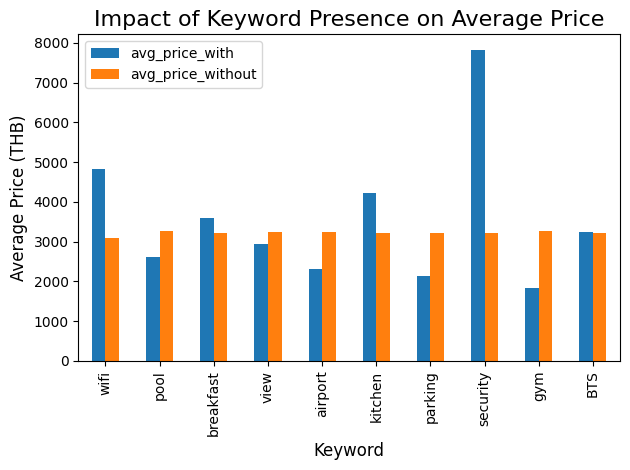

In [31]:
# Calculate the impact of each keyword on price and reviews
for keyword in keywords:
    df_keyword.loc[keyword, "avg_price_with"] = df.loc[df[f"has_{keyword}"], "price"].mean()
    df_keyword.loc[keyword, "avg_price_without"] = df.loc[~df[f"has_{keyword}"], "price"].mean()

# Convert columns to numeric
df_keyword = df_keyword.apply(pd.to_numeric)

plt.figure(figsize=(14, 8))
df_keyword[["avg_price_with", "avg_price_without"]].plot(kind="bar", stacked=False)
plt.title("Impact of Keyword Presence on Average Price", fontsize=16)
plt.xlabel("Keyword", fontsize=12)
plt.ylabel("Average Price (THB)", fontsize=12)
plt.tight_layout()
plt.show()

The graph shows how the presence of specific keywords in listing descriptions impacts the average price. Keywords like "breakfast," "wifi," "kitchen," and "security" are associated with higher prices, indicating that listings highlighting these features can command premium rates.

<Figure size 1400x800 with 0 Axes>

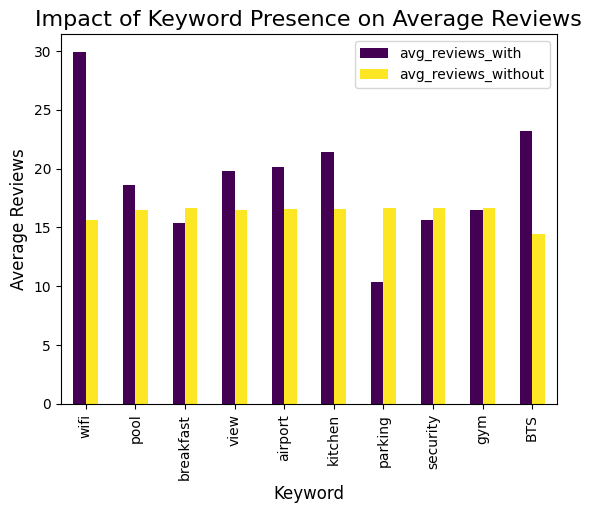

In [32]:
# Calculate the impact of each keyword on reviews
for keyword in keywords:
    df_keyword.loc[keyword, "avg_reviews_with"] = df.loc[df[f"has_{keyword}"], "number_of_reviews"].mean()
    df_keyword.loc[keyword, "avg_reviews_without"] = df.loc[~df[f"has_{keyword}"], "number_of_reviews"].mean()

# Convert columns to numeric
df_keyword = df_keyword.apply(pd.to_numeric)

# Plot the impact of keyword presence on average reviews
plt.figure(figsize=(14, 8))
df_keyword[["avg_reviews_with", "avg_reviews_without"]].plot(kind="bar", stacked=False, colormap="viridis")
plt.title("Impact of Keyword Presence on Average Reviews", fontsize=16)
plt.xlabel("Keyword", fontsize=12)
plt.ylabel("Average Reviews", fontsize=12)
plt.show()

The graph illustrates the relationship between keyword presence and the number of reviews. Keywords such as "wifi," "kitchen," and "pool," "airport," and "view" are associated with a higher number of reviews, suggesting that these features are important to guests and can lead to more bookings.

#### **Strategic Insight**

The analysis of listing descriptions and keywords highlights the critical role that well-crafted text plays in influencing pricing, guest engagement, and overall performance on Airbnb. Key takeaways include:

**1. Leverage High-Value Keywords:**

- **Findings:** Keywords such as "breakfast," "wifi," "kitchen," and "security" are linked to higher listing prices. Properties emphasizing these amenities tend to attract guests willing to pay a premium.
- **Action:** Hosts should prominently feature these keywords in their descriptions when applicable. Highlighting premium amenities boosts the perceived value of the property, supporting higher pricing strategies and appealing to a broader audience.

**2. Highlight Essential Amenities:**

- **Findings:** Words like "wifi," "kitchen," "pool," "airport," and "view" are associated with more guest reviews, reflecting their significance to travelers. These amenities are often considered must-haves.
- **Action:** Including these essential amenities in descriptions can enhance guest satisfaction, drive positive reviews, and improve a listing’s ranking. By meeting guest expectations, hosts can increase occupancy rates and foster repeat bookings.

**3. Optimize with Common Search Terms:**

- **Findings:** Frequently used terms like "room," "near," "Bangkok," and "condo" emphasize location and property type, making listings more relevant to traveler searches.
- **Action:** Using clear, descriptive language that incorporates popular search terms helps improve listing visibility. Hosts should craft descriptions that highlight location and property type, making their offerings more discoverable and attractive to potential guests.

#### **Strategic Recommendations**

1. **Emphasize High-Value Features**: Hosts should highlight any premium amenities such as breakfast, kitchen, or enhanced security in their descriptions to attract guests willing to pay higher prices. The strategic use of these keywords can increase the listing's perceived value and pricing power.

2. **Focus on Essential Amenities**: Ensure that essential features like Wi-Fi, kitchen facilities, and pools are clearly mentioned in the description. These amenities are critical to guest satisfaction and can lead to more bookings and positive reviews, improving the listing’s performance.

3. **Use Clear and Descriptive Language**: Optimize listing descriptions with common keywords that emphasize property type and location. This approach improves visibility in search results and makes the listing more appealing to potential guests, leading to higher engagement.

#### **Conclusion**

The strategic use of keywords and language in Airbnb listing descriptions can significantly influence pricing, guest engagement, and overall performance. By carefully crafting descriptions to highlight key amenities, using common search terms, and considering the language used, hosts can optimize their listings to attract more bookings, command higher prices, and ultimately achieve greater success on the platform.

---

# **Share**

In [33]:
# Save final dataset
df.to_csv('Airbnb Listing Bangkok Final.csv', index=False)

**Here is the Dashboard :**

https://public.tableau.com/app/profile/muhammad.azhar.maulama/viz/AirbnbListingBangkokDashboard/Dashboard1

**Here is the final presentation :**

https://docs.google.com/presentation/d/1S2IIevOshfY0fVzL6MLxs2OHcaEdmlSW/edit?usp=sharing&ouid=109622182444836355742&rtpof=true&sd=true



# **Act**

## **Strategic Recommendations**

### **Geospatial Recommmendations**

**Stand Out in High-Competition Neighbourhoods:**

- **Suggestion:** Hosts in crowded markets should emphasize unique features, such as exceptional amenities, personalized services, or distinct property aesthetics. Offering competitive pricing is also crucial. For new listings, targeting less saturated areas could provide an advantage by reducing direct competition.

**Capitalize on Seasonal Trends:**

- **Suggestion:** Adopt dynamic pricing strategies that adjust rates to align with seasonal demand. During peak tourist seasons, prioritize maximizing revenue through premium pricing, while in off-peak periods, consider offering discounts or flexible booking terms to maintain occupancy.

**Optimize Descriptions with Effective Keywords:**

- **Suggestion:** Craft descriptions with carefully chosen keywords to improve visibility and appeal, ultimately driving more bookings and higher pricing. For international travelers, providing descriptions in English can significantly enhance accessibility and broaden market reach.

### **Trend Recommendations**

**Dynamic Pricing:** 
- **Suggestion:** Adopt a pricing strategy that adjusts rates in response to seasonal demand. This approach ensures maximum revenue during peak seasons and maintains competitiveness during slower periods.

**Seasonal Marketing:** 
- **Suggestion:** Tailor marketing efforts to align with seasonal trends. Focus on high-demand months to secure more bookings, and use promotions or discounts during off-peak times to encourage reservations.


### **Engagement Based on Review Recommendations**


**Enhancing Long-Term Engagement:** 

- **Suggestion:** Focus on maintaining consistent quality and encouraging guests to leave reviews to increase total review counts over time.

**Boosting Monthly Activity:** 
- **Suggestion:** Implement short-term strategies like promotional pricing or targeted marketing to boost bookings and reviews in the short term, especially for newer listings.

**Learning from Top Listings:** 
- **Suggestion:** Study the features, pricing, and descriptions of the highest-ranked listings to identify what makes them stand out.
These insights can help hosts refine their strategies and improve the overall performance of their listings.


### **Listing Description Recommendations**

**Emphasize High-Value Features:** 
- **Suggestion:** Hosts should highlight any premium amenities such as breakfast, kitchen, or enhanced security in their descriptions to attract guests willing to pay higher prices. The strategic use of these keywords can increase the listing's perceived value and pricing power.

**Focus on Essential Amenities:** 
- **Suggestion:** Ensure that essential features like Wi-Fi, kitchen facilities, and pools are clearly mentioned in the description. These amenities are critical to guest satisfaction and can lead to more bookings and positive reviews, improving the listing’s performance.

**Use Clear and Descriptive Language:** 
- **Suggestion:** Optimize listing descriptions with common keywords that emphasize property type and location. This approach improves visibility in search results and makes the listing more appealing to potential guests, leading to higher engagement.

### **Additional Data**

Additional data that could be useful includes ratings, which provide insights into the guest experience at the accommodation or listing.